In [1]:
from logger import Logger
import torch
from torch import nn, optim
from torchvision import transforms, datasets

DATA_FOLDER = './torch_data/DCGAN/CIFAR'

def cifar_data():
    compose = transforms.Compose(
        [
            transforms.Resize(64),
            transforms.ToTensor(),
            transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ])
    out_dir = '{}/dataset'.format(DATA_FOLDER)
    return datasets.CIFAR10(root=out_dir, train=True, transform=compose, download=True)

data = cifar_data()
batch_size = 100
data_loader = torch.utils.data.DataLoader(data, batch_size=batch_size, shuffle=True)
num_batches = len(data_loader)

Files already downloaded and verified


In [6]:
class DiscriminativeNet(torch.nn.Module):
    
    def __init__(self):
        super(DiscriminativeNet, self).__init__()
        
        self.conv1 = nn.Sequential(
            nn.Conv2d(
                in_channels=3, out_channels=128, kernel_size=4, 
                stride=2, padding=1, bias=False
            ),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(
                in_channels=128, out_channels=256, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(
                in_channels=256, out_channels=512, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(
                in_channels=512, out_channels=1024, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.out = nn.Sequential(
            nn.Linear(1024*4*4, 1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        # Convolutional layers
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        # Flatten and apply sigmoid
        x = x.view(-1, 1024*4*4)
        x = self.out(x)
        return x

class GenerativeNet(torch.nn.Module):
    
    def __init__(self):
        super(GenerativeNet, self).__init__()
        
        self.linear = torch.nn.Linear(100, 1024*4*4)
        
        self.conv1 = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels=1024, out_channels=512, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels=512, out_channels=256, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        self.conv3 = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels=256, out_channels=128, kernel_size=4,
                stride=2, padding=1, bias=False
            ),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        self.conv4 = nn.Sequential(
            nn.ConvTranspose2d(
                in_channels=128, out_channels=3, kernel_size=4,
                stride=2, padding=1, bias=False
            )
        )
        self.out = torch.nn.Tanh()

    def forward(self, x):
        # Project and reshape
        x = self.linear(x)
        x = x.view(x.shape[0], 1024, 4, 4)
        # Convolutional layers
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        # Apply Tanh
        return self.out(x)




def real_data_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = torch.ones(size, 1)
    if torch.cuda.is_available(): return data.to('cuda:1')
    return data

def fake_data_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = torch.zeros(size, 1)
    if torch.cuda.is_available(): return data.to('cuda:1')
    return data

def train_discriminator(optimizer, real_data, fake_data):
    # Reset gradients
    optimizer.zero_grad()
    
    # Propagate real data
    prediction_real = discriminator(real_data)
    error_real = loss(prediction_real, real_data_target(real_data.size(0)))
    error_real.backward()

    # Propagate fake data
    prediction_fake = discriminator(fake_data)
    error_fake = loss(prediction_fake, fake_data_target(real_data.size(0)))
    error_fake.backward()
    
    # Take a step
    optimizer.step()
    
    # Return error
    return error_real + error_fake, prediction_real, prediction_fake


def train_generator(optimizer, fake_data):
    # Reset gradients
    optimizer.zero_grad()

    # Propagate the fake data through the discriminator and backpropagate.
    # Note that since we want the generator to output something that gets
    # the discriminator to output a 1, we use the real data target here.
    prediction = discriminator(fake_data)
    error = loss(prediction, real_data_target(prediction.size(0)))
    error.backward()
    
    # Update weights with gradients
    optimizer.step()
    
    # Return error
    return error

def noise(batchSize):
    n = torch.randn(batchSize, 100)
    if torch.cuda.is_available(): return n.to('cuda:1') 
    return n

In [4]:
# Custom weight initialization

def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1 or classname.find('BatchNorm') != -1:
        m.weight.data.normal_(0.00, 0.02)

# Instantiate networks

generator = GenerativeNet()
generator.apply(init_weights)
discriminator = DiscriminativeNet()
discriminator.apply(init_weights)

# Enable cuda if available
device = 'cuda:1'
# if torch.cuda.is_available():
generator.to(device)
discriminator.to(device)


The history saving thread hit an unexpected error (OperationalError('disk I/O error',)).History will not be written to the database.


DiscriminativeNet(
  (conv1): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv3): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (conv4): Sequential(
    (0): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (out): Sequential(
    (0): Linea

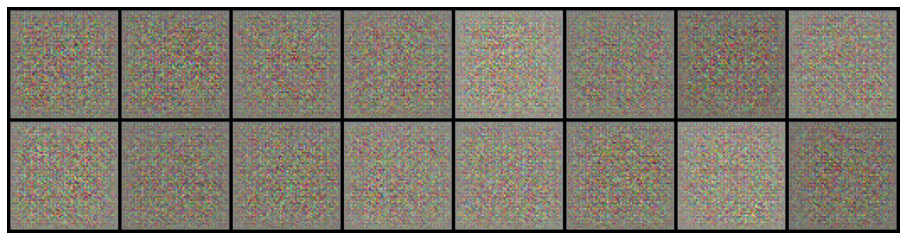

Epoch: [0/30], Batch Num: [0/500]
Discriminator Loss: 1.3621, Generator Loss: 0.7349
D(x): 0.5017, D(G(z)): 0.4895


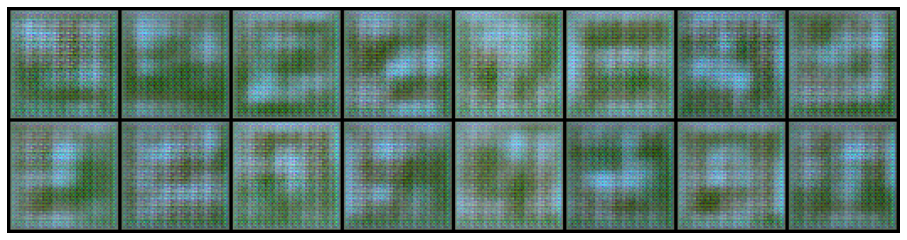

Epoch: [0/30], Batch Num: [100/500]
Discriminator Loss: 0.0340, Generator Loss: 4.4291
D(x): 0.9859, D(G(z)): 0.0195


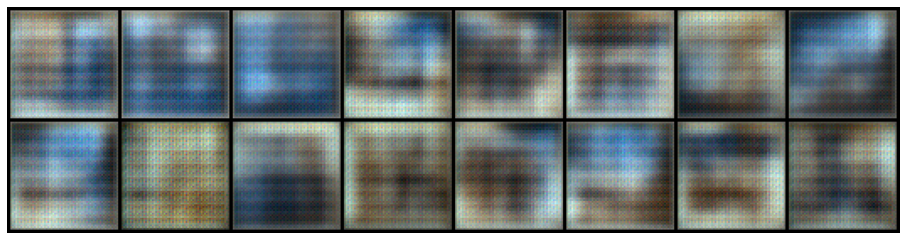

Epoch: [0/30], Batch Num: [200/500]
Discriminator Loss: 0.4809, Generator Loss: 3.2514
D(x): 0.7709, D(G(z)): 0.1709


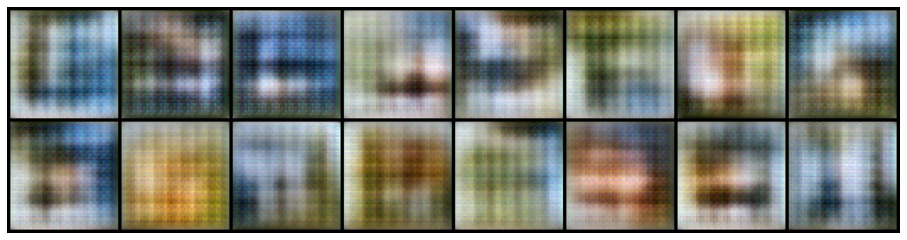

Epoch: [0/30], Batch Num: [300/500]
Discriminator Loss: 0.8665, Generator Loss: 4.5225
D(x): 0.8601, D(G(z)): 0.4486


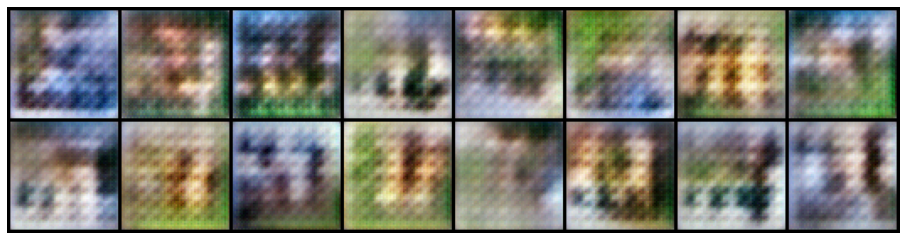

Epoch: [0/30], Batch Num: [400/500]
Discriminator Loss: 0.5171, Generator Loss: 3.9358
D(x): 0.8320, D(G(z)): 0.2584


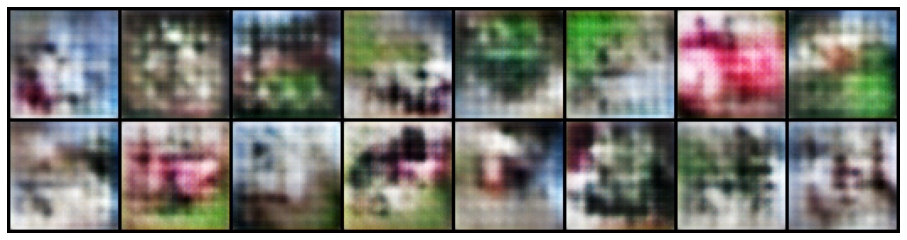

Epoch: [1/30], Batch Num: [0/500]
Discriminator Loss: 0.6368, Generator Loss: 3.1312
D(x): 0.8867, D(G(z)): 0.3710


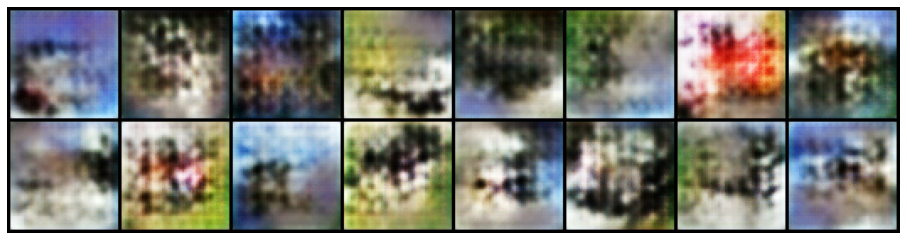

Epoch: [1/30], Batch Num: [100/500]
Discriminator Loss: 1.5511, Generator Loss: 2.5972
D(x): 0.9053, D(G(z)): 0.7492


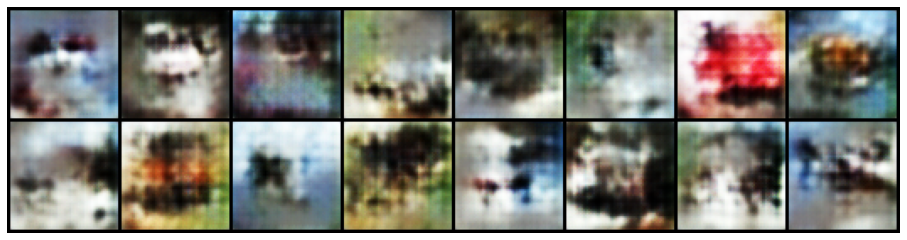

Epoch: [1/30], Batch Num: [200/500]
Discriminator Loss: 1.0562, Generator Loss: 2.5272
D(x): 0.7622, D(G(z)): 0.5046


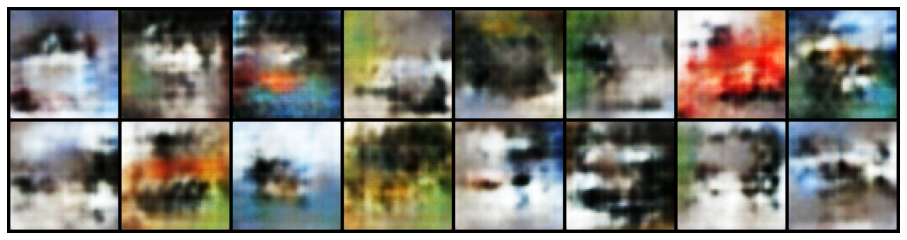

Epoch: [1/30], Batch Num: [300/500]
Discriminator Loss: 0.7000, Generator Loss: 2.3032
D(x): 0.7381, D(G(z)): 0.3025


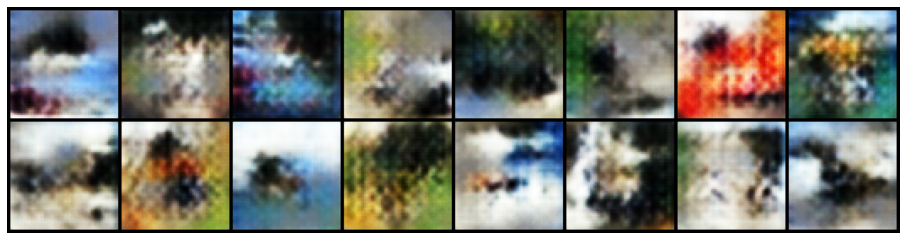

Epoch: [1/30], Batch Num: [400/500]
Discriminator Loss: 0.9510, Generator Loss: 2.0902
D(x): 0.6854, D(G(z)): 0.3997


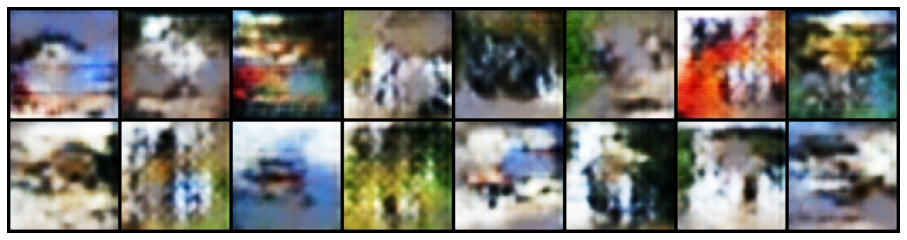

Epoch: [2/30], Batch Num: [0/500]
Discriminator Loss: 1.2573, Generator Loss: 0.9233
D(x): 0.4106, D(G(z)): 0.2321


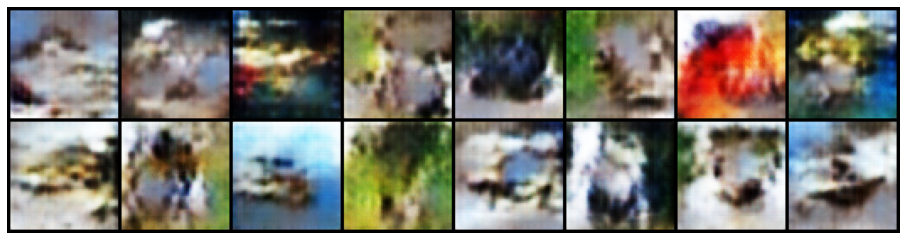

Epoch: [2/30], Batch Num: [100/500]
Discriminator Loss: 0.9059, Generator Loss: 1.3916
D(x): 0.5475, D(G(z)): 0.2037


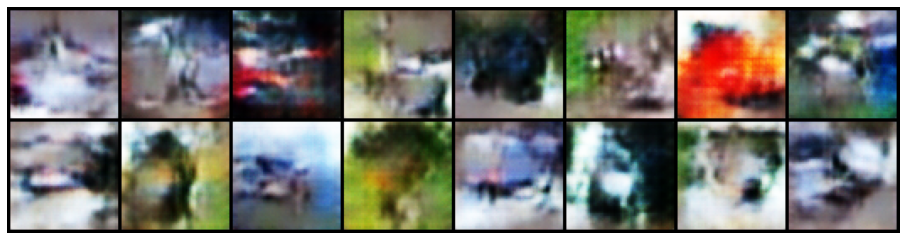

Epoch: [2/30], Batch Num: [200/500]
Discriminator Loss: 0.7294, Generator Loss: 2.1065
D(x): 0.6948, D(G(z)): 0.2772


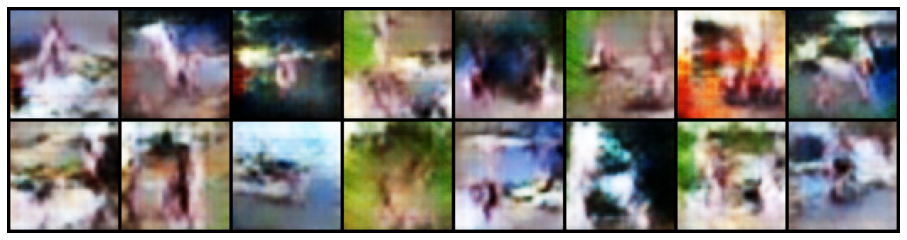

Epoch: [2/30], Batch Num: [300/500]
Discriminator Loss: 1.1375, Generator Loss: 2.4447
D(x): 0.8746, D(G(z)): 0.6016


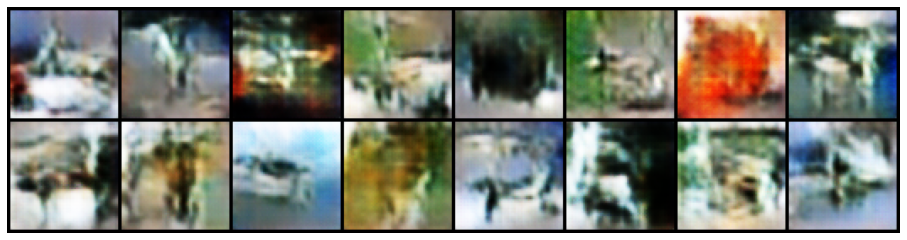

Epoch: [2/30], Batch Num: [400/500]
Discriminator Loss: 0.8217, Generator Loss: 1.4381
D(x): 0.6586, D(G(z)): 0.2942


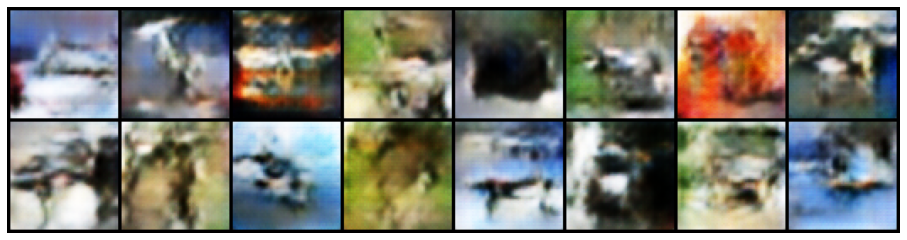

Epoch: [3/30], Batch Num: [0/500]
Discriminator Loss: 0.9898, Generator Loss: 1.5017
D(x): 0.5762, D(G(z)): 0.3219


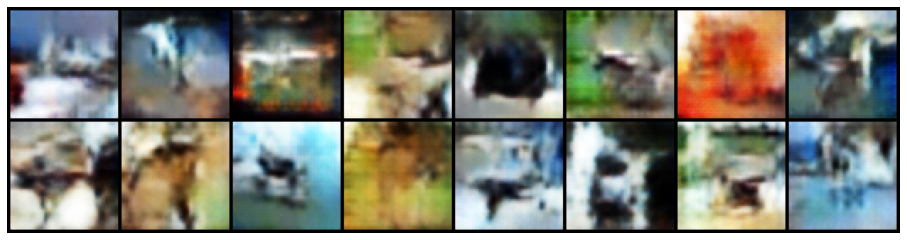

Epoch: [3/30], Batch Num: [100/500]
Discriminator Loss: 1.0407, Generator Loss: 1.9584
D(x): 0.7665, D(G(z)): 0.5160


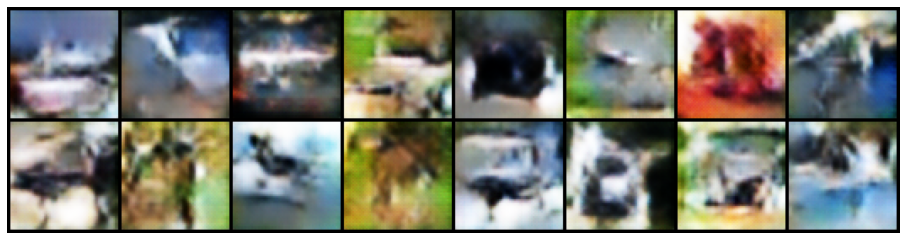

Epoch: [3/30], Batch Num: [200/500]
Discriminator Loss: 0.9486, Generator Loss: 3.8444
D(x): 0.8739, D(G(z)): 0.5359


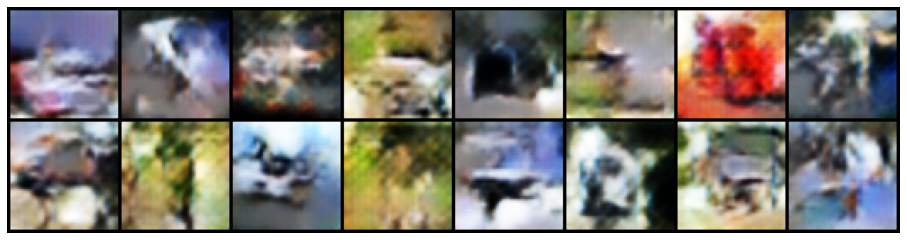

Epoch: [3/30], Batch Num: [300/500]
Discriminator Loss: 0.6878, Generator Loss: 2.1687
D(x): 0.8448, D(G(z)): 0.3870


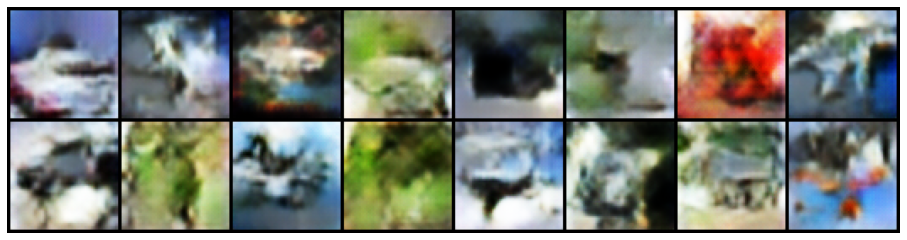

Epoch: [3/30], Batch Num: [400/500]
Discriminator Loss: 0.4688, Generator Loss: 1.6588
D(x): 0.7325, D(G(z)): 0.1344


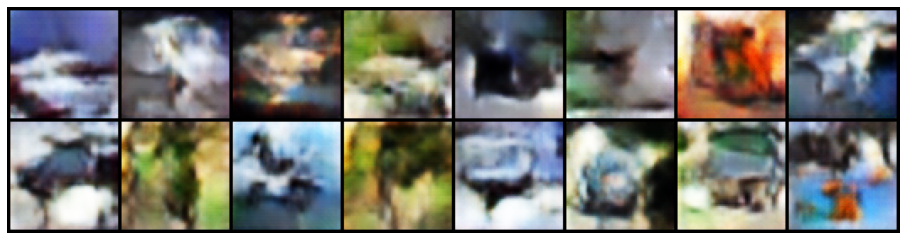

Epoch: [4/30], Batch Num: [0/500]
Discriminator Loss: 0.6947, Generator Loss: 2.7816
D(x): 0.8565, D(G(z)): 0.3997


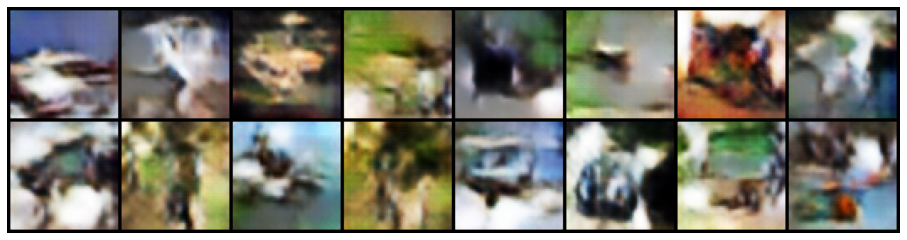

Epoch: [4/30], Batch Num: [100/500]
Discriminator Loss: 0.7145, Generator Loss: 4.2688
D(x): 0.9474, D(G(z)): 0.4627


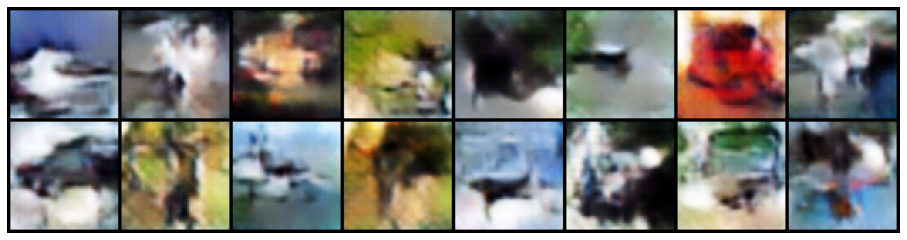

Epoch: [4/30], Batch Num: [200/500]
Discriminator Loss: 0.9952, Generator Loss: 1.2395
D(x): 0.4886, D(G(z)): 0.2023


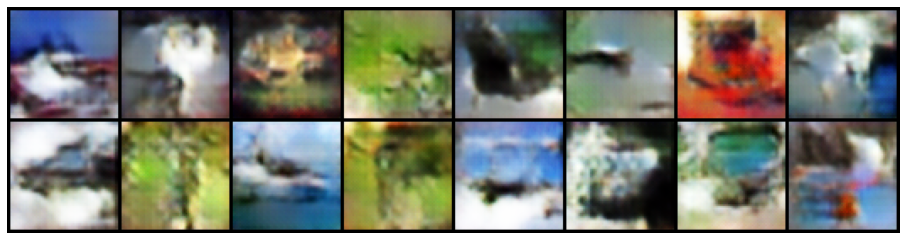

Epoch: [4/30], Batch Num: [300/500]
Discriminator Loss: 1.0513, Generator Loss: 2.7078
D(x): 0.8668, D(G(z)): 0.5736


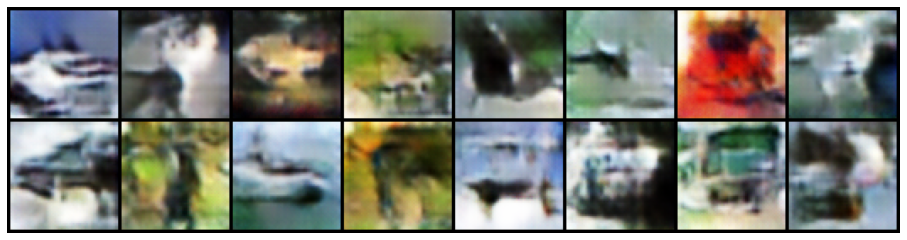

Epoch: [4/30], Batch Num: [400/500]
Discriminator Loss: 0.9667, Generator Loss: 1.9797
D(x): 0.6354, D(G(z)): 0.3583


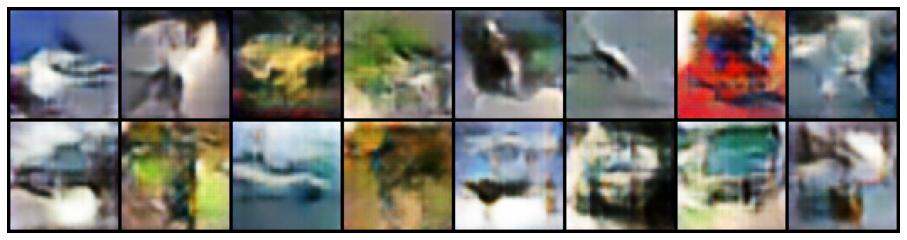

Epoch: [5/30], Batch Num: [0/500]
Discriminator Loss: 0.9344, Generator Loss: 1.9564
D(x): 0.6958, D(G(z)): 0.4042


In [8]:

# Optimizers

d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Loss function

loss = nn.BCELoss()

# Number of epochs of training
num_epochs = 30

num_test_samples = 16
test_noise = noise(num_test_samples)

logger = Logger(model_name='DCGAN', data_name='CIFAR10')

for epoch in range(num_epochs):
    for n_batch, (real_data,_) in enumerate(data_loader):

        # Train Discriminator
        
        # if torch.cuda.is_available(): 
        real_data = real_data.to('cuda:1')
        fake_data = generator( noise(real_data.size(0)) ).detach()
        d_error, d_pred_real, d_pred_fake = train_discriminator(d_optimizer, real_data, fake_data)

        # Train Generator
        
        fake_data = generator(noise(real_data.size(0)))
        g_error = train_generator(g_optimizer, fake_data)

        # Log error and display progress
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        if (n_batch) % 100 == 0:
            # display.clear_output(True)
            # Display Images
            test_images = generator(test_noise).data.cpu()
            logger.log_images(test_images, num_test_samples, epoch, n_batch, num_batches);
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

        # Save model checkpoints
        logger.save_models(generator, discriminator, epoch)